#  NEURAL NETWORKS AND DEEP LEARNING :

### Group members :

- Mojtaba Roshana

- Asal Rangrazi Asl

- Roya Joulaeivijouyeh

### Project proposals : Image Recoloring with conditional GANs

### Dataset description : (ImageNet-1000)

- The dataset we are using for this project is basically a sample of the well-known and substantial image-net dataset.

- In this project, we trained and evaluated our models using 5000 samples from the dataset.


### Model description :

- Conditional Generative Adversarial Networks (cGAN) is a variant of Generative Adversarial Networks (GANs) where both the generator and the discriminator are conditioned on additional information. In a cGAN, the generator tries to generate data samples based on both a random noise vector and a conditioning input.

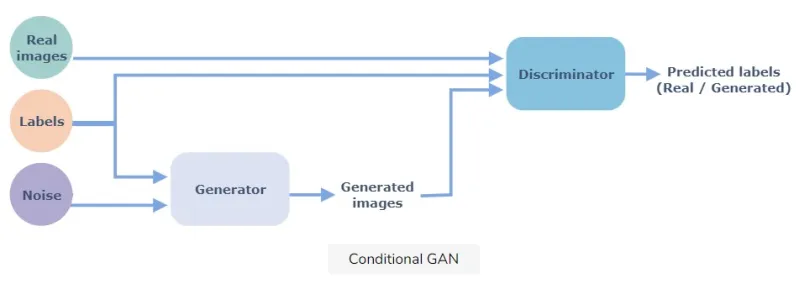

### Main Required Steps :

1. Choose a Dataset and write the Dataset class to transform the images to grayscale.
2. Implement the UNET Autoencoder.(generator)
3. Implement the patch GAN.(discriminator)
4. Setup the losses and train the system.
5. Improve the model with some of the suggestions or propose something yourself.

The paper uses the whole ImageNet dataset (with 1.3 million images!) but here we are using only 5000 images.

### 1.1- Loading Image Paths: 

In [ ]:
!pip install fastai==2.4

In [ ]:
import os
import glob
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb
import pandas as pd

import torch
from torch import nn, optim
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
use_colab = None

In [ ]:
device

device(type='cuda')

In [ ]:
import fastai
fastai.__version__

'2.4'

In [ ]:
import torch
torch.__version__

'1.9.1+cu102'

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!cp -R /content/drive/MyDrive/DNN_final_project/5k /content/

 Downloading data directly if we want to have more data with kaggle API Imagenetmini.In this project we are using 5000 data becuase our recources are limited.


In [ ]:
#! pip install kaggle
# ! mkdir ~/.kaggle
# ! cp kaggle.json ~/.kaggle/
# ! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
#! kaggle datasets download ifigotin/imagenetmini-1000

In [ ]:
#! unzip imagenetmini-1000

### loading Dataset :

- collect 5000 data and devide them for training set and test set.


### splitting Data :

- Data splitting is when data is divided into two or more subsets. Typically, with a two-part split, one part is used to evaluate or test the data and the other to train the model. Data splitting is an important aspect of data science, particularly for creating models based on data.

- We assume 80% (4000 images) of data as the train set and 20%  (1000 images) as the validation set.



In [ ]:
#path = "/content/5k/"
path = "/content/drive/MyDrive/DNN_final_project/5k"

paths = glob.glob(path + "/*.JPEG") # Grabbing all the image file names
np.random.seed(123)
paths_subset = np.random.choice(paths, 5000, replace=False) # choosing 1000 images randomly
rand_idxs = np.random.permutation(5000)
train_idxs = rand_idxs[:4000] # choosing the first 4000 as training set
val_idxs = rand_idxs[4000:] # choosing last 1000 as validation set
train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]
print(len(train_paths), len(val_paths))

4000 1000


### this is just simple visualization of dataset :

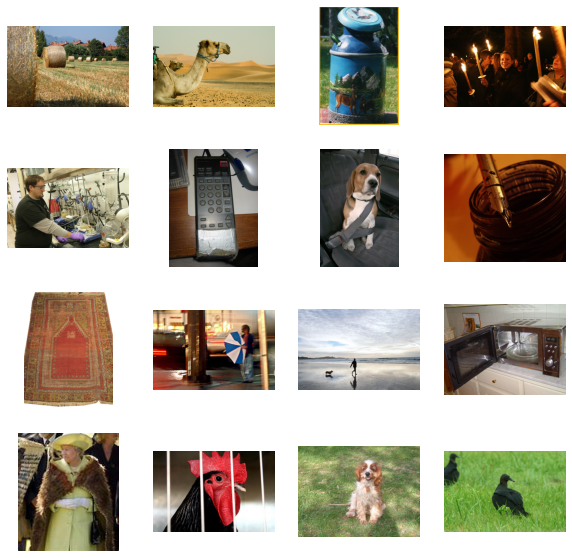

In [ ]:
_, axes = plt.subplots(4, 4, figsize=(10, 10))
for ax, img_path in zip(axes.flatten(), train_paths):
    ax.imshow(Image.open(img_path))
    ax.axis("off")

### loading images in machine :

- we use Lab color space instead of RGB to train the models because To train a model for colorization,we should give it a grayscale image and hope that it will make it colorful. When using Lab, we can give the L channel to the model (which is the grayscale image) and want it to predict the other two channels (a, b) and after its prediction, we concatenate all the channels and we get our colorful image.

 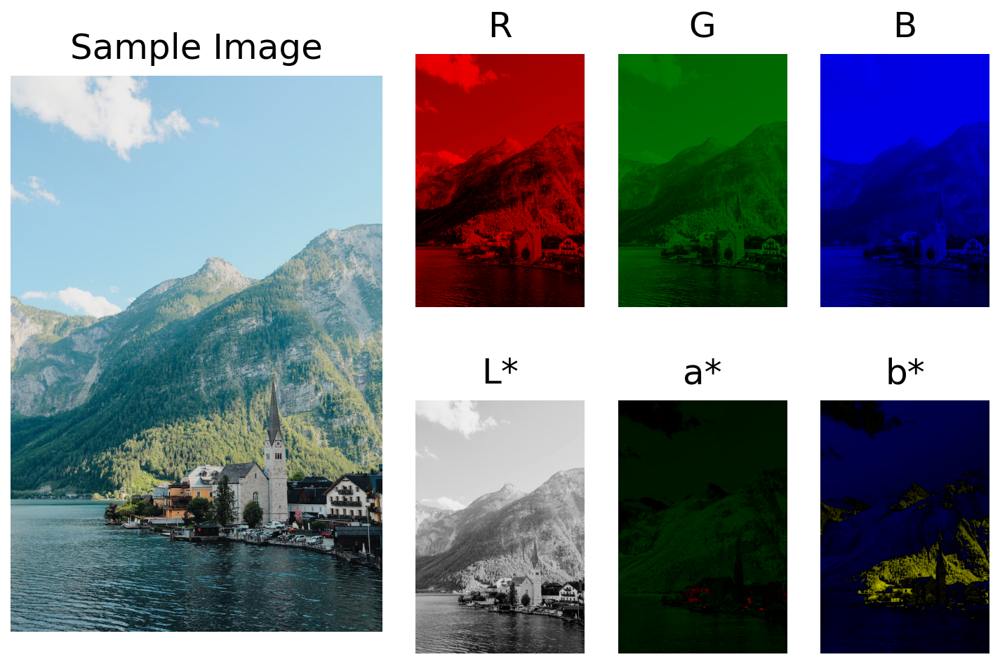

###  Making Datasets and DataLoaders :

We resize the images and flipping horizontally (flipping only if it is training set), and read the RGB image. Then convert it to Lab color space and separate the first (grayscale) channel and the color channels. Then define the data loaders.

In [ ]:
SIZE = 256
class ColorizationDataset(Dataset):
    def __init__(self, paths, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE),  Image.BICUBIC),
                transforms.RandomHorizontalFlip(), # A little data augmentation!
            ])
        elif split == 'val':
            self.transforms = transforms.Resize((SIZE, SIZE),  Image.BICUBIC)
        
        self.split = split
        self.size = SIZE
        self.paths = paths
    
    def __getitem__(self, idx):
        img = Image.open(self.paths[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1
        
        return {'L': L, 'ab': ab}
    
    def __len__(self):
        return len(self.paths)

def make_dataloaders(batch_size=16, n_workers=0, pin_memory=True, **kwargs): # A handy function to make our dataloaders
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,
                            pin_memory=pin_memory)
    return dataloader

In [ ]:
train_dl = make_dataloaders(paths=train_paths, split='train')
val_dl = make_dataloaders(paths=val_paths, split='val')

data = next(iter(train_dl))
Ls, abs_ = data['L'], data['ab']
print(Ls.shape, abs_.shape)
print(len(train_dl), len(val_dl))

/usr/local/lib/python3.8/dist-packages/torchvision/transforms/transforms.py:280: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])
250 63


###  Generator proposed by the paper : ( U-NET )

- A generator in a Generative Adversarial Network (GAN) is a deep learning model designed to generate new data samples that are similar to a target dataset. A UNet is a specific type of generator architecture that is used for image-to-image translation tasks, like our project goal (Image Colorization).

 
 

 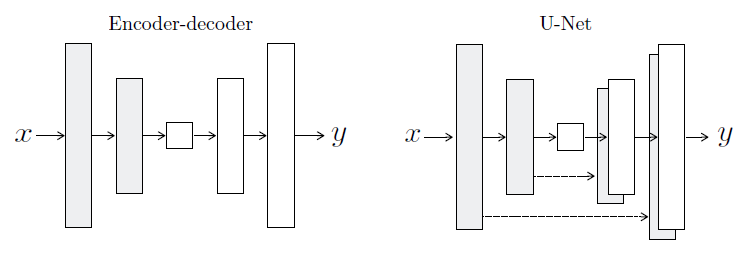

- UNet is composed of an encoder and a decoder, which are mirror images of each other. The encoder compresses the input image into a lower-dimensional feature representation, while the decoder expands the feature representation back into an output image. The encoder and decoder are connected by skip connections, which help to preserve spatial information and improve the quality of the generated image.

- This UNet which we build has 8 layers down, so if we start with a 256 by 256 image, in the middle of the U-Net we will get a 1 by 1 (256 / 2⁸) image and then it gets up-sampled to produce a  256 by 256 image (with two channels).

### Generator architectures:
The encoder-decoder architecture consists of:

encoder:
C64-C128-C256-C512-C512-C512-C512-C512

decoder:
CD512-CD512-CD512-C512-C256-C128-C64

After the last layer in the decoder, a convolution is applied to map to the number of output channels (2 chanels in colorization task), followed by a Tanh function. As an exception to the above notation, Batch- Norm is not applied to the first C64 layer in the encoder. All ReLUs in the encoder are leaky, with slope 0.2, while ReLUs in the decoder are not leaky. The U-Net architecture is identical except with skip connections between each layer i in the encoder and layer n-i in the decoder, where n is the total number of layers. The skip connections concatenate activations from layer i to layer n - i. This changes the number of channels in the
decoder:

### U-Net decoder:
CD512-CD1024-CD1024-C1024-C1024-C512-C256-C128

In [ ]:
class UnetBlock(nn.Module):
    def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                 innermost=False, outermost=False):
        super().__init__()
        self.outermost = outermost
        if input_c is None: input_c = nf
        downconv = nn.Conv2d(input_c, ni, kernel_size=4,
                             stride=2, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)
        
        if outermost:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            if dropout: up += [nn.Dropout(0.5)]
            model = down + [submodule] + up
        self.model = nn.Sequential(*model)
    
    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)

class Unet(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)
    
    def forward(self, x):
        return self.model(x)

###  Discriminator : (patchGAN)

- PatchGANs are a useful technique for image generation tasks, as they can produce high-quality, realistic images while improving stability and efficiency during training.



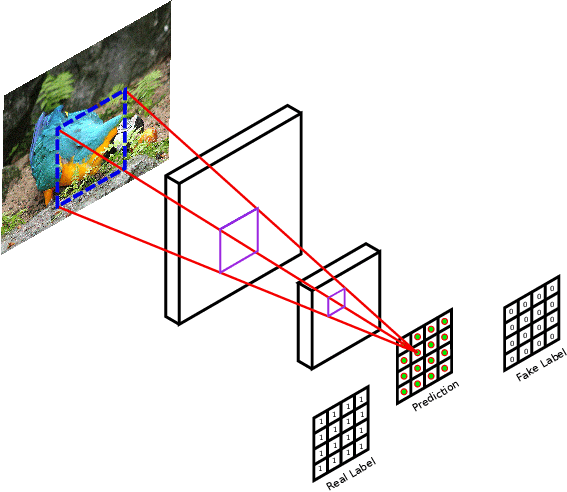

- In a patch discriminator, the model outputs one number for every patch of say 70 by 70 pixels of the input image and for each of them decides whether it is fake or not separately.

- The architecture of our discriminator is rather straight forward. Here we implements a model by stacking blocks of Conv-BatchNorm-LeackyReLU to decide whether the input image is fake or real. Notice that the first and last blocks there is nonormalization and the last block has no activation function (it is embedded in the loss function we will use).

- Discriminator architectures:

 The discriminator structure will follow
the pattern build of C64-C128-C256-C512. We implement a
model by stacking blocks of Conv-BatchNorm-LeackyReLU
to decide whether the input image is fake or real. Besides, first
and last blocks do not use normalization and the last block
has no activation function(It is embedded in the loss function)

In [ ]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2) 
                          for i in range(n_down)] # the 'if' statement is taking care of not using
                                                  # stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Make sure to not use normalization or
                                                                                             # activation for the last layer of the model
        self.model = nn.Sequential(*model)                                                   
        
    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # when needing to make some repeatitive blocks of layers,
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]          # it's always helpful to make a separate method for that purpose
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)
    
    def forward(self, x):
        return self.model(x)

In [ ]:
PatchDiscriminator(3)

PatchDiscriminator(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (

And its output shape:

- Here, the model's output shape is 30 by 30 but it does not mean that our patches are 30 by 30. The actual patch size is obtained when you compute the receptive field of each of these 900 (30 multiplied by 30) output numbers which in our case will be 70 by 70.**



In [ ]:
discriminator = PatchDiscriminator(3)
dummy_input = torch.randn(16, 3, 256, 256) # batch_size, channels, size, size
out = discriminator(dummy_input)
out.shape

torch.Size([16, 1, 30, 30])

# GAN Loss:

- The loss function in a cGAN typically consists of two components: the generator loss and the discriminator loss. The generator loss measures how well the generator is able to fool the discriminator, while the discriminator loss measures how well the discriminator is able to distinguish between real and generated samples.

### Generator loss :

- The generator loss is usually defined as the negative log-likelihood of the discriminator's output, given the generated sample and the conditioning input. The generator tries to minimize this loss, which encourages it to generate samples that are classified as real by the discriminator.

### Discriminator loss :
- The discriminator loss measures the binary cross-entropy between the true labels (real or fake) and the discriminator's predictions. The discriminator tries to maximize this loss, which encourages it to produce accurate predictions.

 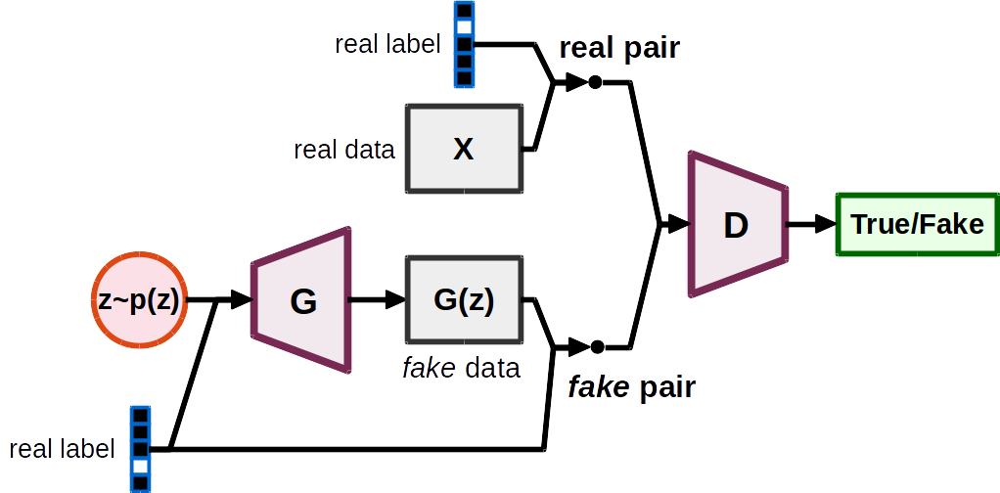

- This is a handy class we can use to calculate the GAN loss of our final model. In the __init__ we decide which kind of loss we're going to use (which will be "vanilla" in our project) and register some constant tensors as the "real" and "fake" labels. Then when we call this module, it makes an appropriate tensor full of zeros or ones (according to what we need at the stage) and computes the loss.

- we use L1 loss as well and compute the distance between the predicted two channels and the target two channels and multiply this loss by a coefficient (which is 100 in our case) to balance the two losses and then add this loss to the adversarial loss. Then we call the backward method of the loss.

In [ ]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()
    
    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)
    
    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

###  Model Initialization :

- Here is our logic to initialize our models. We are going to initialize the weights of our modelwhich are the proposed hyperparameters in the article, with:

1. mean= 0.0

2. standard deviation = 0.02 

 

In [ ]:
def init_weights(net, init='norm', gain=0.02):
    
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            
            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)
            
    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

### Main Model :

- step1: This class brings together all the previous parts and implements a few methods to take care of training our complete model.   

- step2: In the __init__  our generator and discriminator using the previous functions and classes which defined and also initialize them with init_model function.

- step 3: using module's forward method (only once per iteration (batch of training set)) and store the outputs in fake_color variable of the class. 

- step4: first train the discriminator by using backward_D method in which we feed the fake images produced by generator to the discriminator and label them as fake.

- step5: Then feed a batch of real images from training set to the discriminator and label them as real. also add up the two losses for fake and real and take the average and then call the backward on the final loss.

- step6: train the generator. In backward_G method feed the discriminator the fake image and try to fool it by assigning real labels to them and calculating the adversarial loss. 

We use minibatch SGD and apply the Adam solver, with a learning rate of 0.0002,
and momentum parameters beta1 = 0.5, beta2 = 0.999 . These parameteres obtained by the refrance paper.

In [ ]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4, 
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()
        
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1
        
        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))
    
    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad
        
    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
    def forward(self):
        self.fake_color = self.net_G(self.L)
    
    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()
    
    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()
    
    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()
        
        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

### Utility functions :

- some utility functions to log the losses of our network and also visualize the results during training.

In [ ]:
class AverageMeter:
    def __init__(self):
        self.reset()
        
    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3
    
    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """
    
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)
    
def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")
        
def log_results(loss_meter_dict,show=True):
    res = {}
    for loss_name, loss_meter in loss_meter_dict.items():
        if show:
          print(f"{loss_name}: {loss_meter.avg:.5f}")
        res[loss_name] = loss_meter.avg
    
    return res

### Train Model :

- We train the model for 6 different group of images.

- Every epoch takes about 3 to 4 minutes on Colab.

- In this step we train it for 30 epoch as it took a long time to train.

- But in each step you can see the changes.

- By training this model for more than 50 epoch we can see step by step reasonable results. 

- Also for the perfect result we have to train it in 100 epochs.

In [ ]:
results = []
show=False
def train_model(model, train_dl, epochs, display_every=1):
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intrvals
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to 
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data) 
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i in [1,5,10,50,100,249]:
                visualize(model, data, save=False) # function displaying the model's outputs
                show=True
            else:
                show=False
            if show:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
            results.append(log_results(loss_meter_dict,show=show)) # function to print out the losses
                

model = MainModel()
train_model(model, train_dl, 30)

### save the model after training: 

In [ ]:
import pandas as pd
torch.save(model, '/content/drive/MyDrive/ DNN_final_project/model.pt')
df=pd.DataFrame(results)
df.to_csv('/content/drive/MyDrive/ DNN_final_project/raw_data.csv')

### visualization of losses:

- these plots is just for 45 epoches but if you can see even for the 45 epoch we can realize the decreasing of losses.

- if we had the powerfull system, we were able to show these plots for 100 epoches.

### model summery :

In [ ]:
map_location=torch.device('cuda')
model = torch.load('/content/drive/MyDrive/ DNN_final_project/model.pt')
model.eval()

MainModel(
  (net_G): Unet(
    (model): UnetBlock(
      (model): Sequential(
        (0): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
        (1): UnetBlock(
          (model): Sequential(
            (0): LeakyReLU(negative_slope=0.2, inplace=True)
            (1): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
            (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (3): UnetBlock(
              (model): Sequential(
                (0): LeakyReLU(negative_slope=0.2, inplace=True)
                (1): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
                (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
                (3): UnetBlock(
                  (model): Sequential(
                    (0): LeakyReLU(negative_slope=0.2, inplace=True)
                    (1): Conv2d(256, 512, kernel_s

In the google colab we can not run the code moLoading and run the model from epoch 30 to 45

In [ ]:
!cp -R /content/drive/MyDrive/DNN_final_project/5k_model /content/

In [ ]:
map_location=torch.device('cuda')
model = torch.load('/content/5k_model/Copy of model.pt')

In [ ]:
import pandas as pd
df = pd.read_csv('/content/5k_model/Copy of raw_data.csv')


  0%|          | 0/250 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


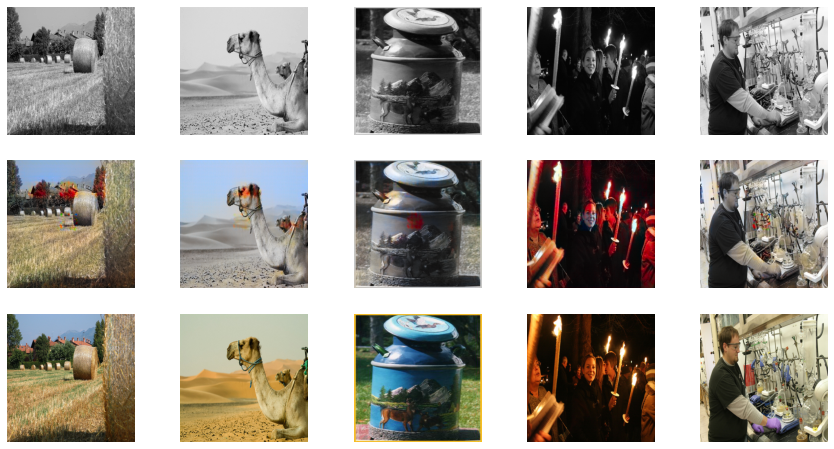


Epoch 31/45
Iteration 1/250
loss_D_fake: 1.31018
loss_D_real: 0.06022
loss_D: 0.68520
loss_G_GAN: 1.06408
loss_G_L1: 8.69902
loss_G: 9.76310


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 18 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 16 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


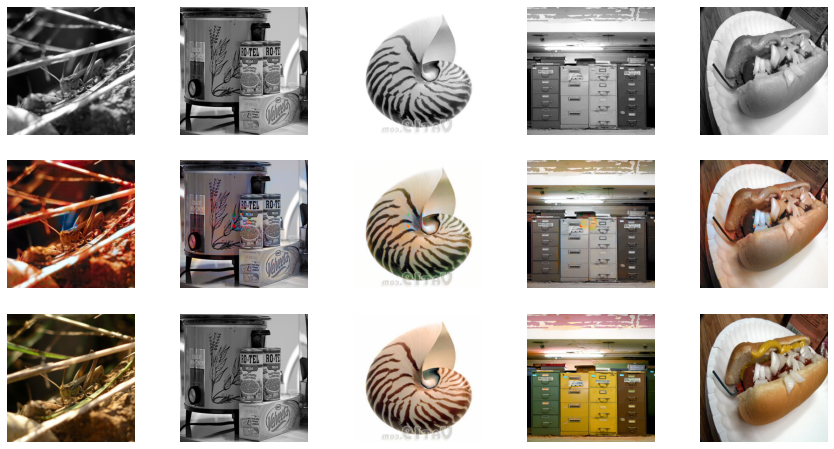


Epoch 31/45
Iteration 10/250
loss_D_fake: 0.54363
loss_D_real: 0.43827
loss_D: 0.49095
loss_G_GAN: 1.30136
loss_G_L1: 8.39355
loss_G: 9.69491


  0%|          | 0/250 [00:00<?, ?it/s]

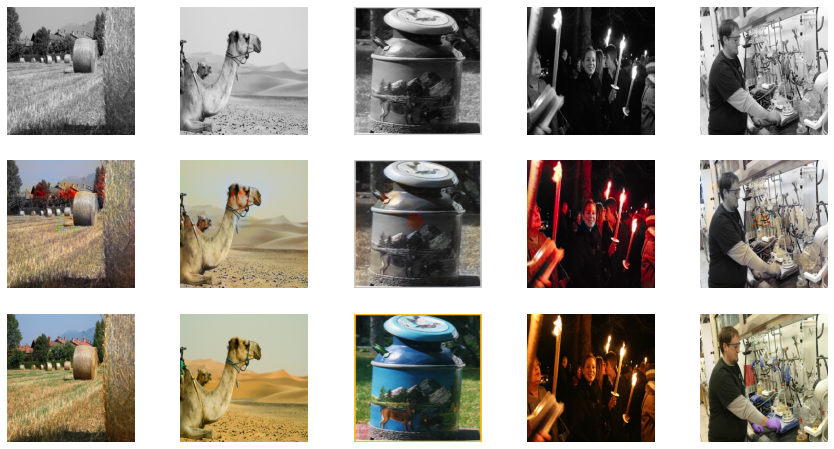


Epoch 32/45
Iteration 1/250
loss_D_fake: 0.79819
loss_D_real: 0.11143
loss_D: 0.45481
loss_G_GAN: 1.52963
loss_G_L1: 8.41817
loss_G: 9.94780


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 13 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


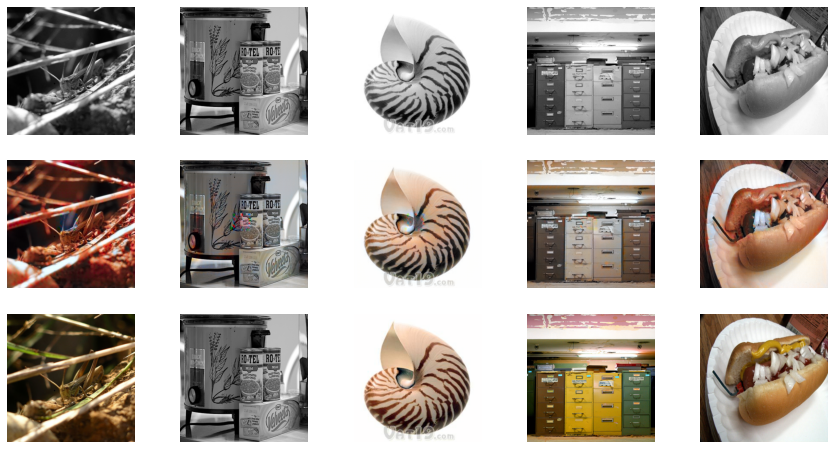


Epoch 32/45
Iteration 10/250
loss_D_fake: 0.54078
loss_D_real: 0.53305
loss_D: 0.53691
loss_G_GAN: 1.25138
loss_G_L1: 8.44231
loss_G: 9.69369


  0%|          | 0/250 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


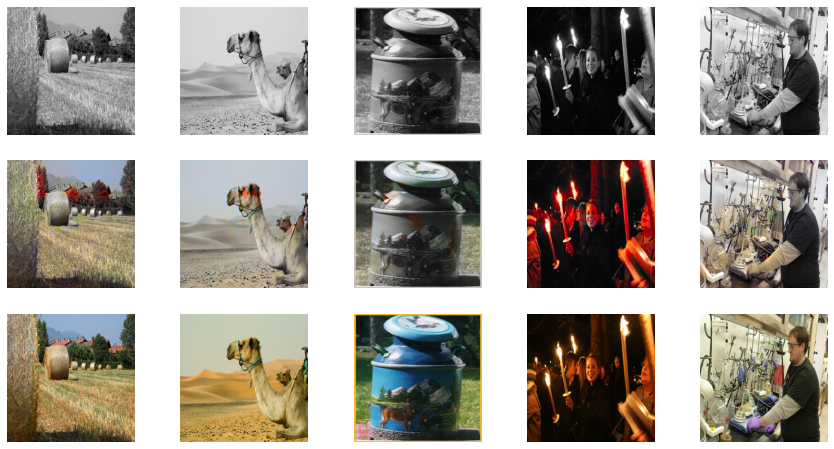


Epoch 33/45
Iteration 1/250
loss_D_fake: 0.87003
loss_D_real: 0.14309
loss_D: 0.50656
loss_G_GAN: 1.15280
loss_G_L1: 8.66397
loss_G: 9.81678


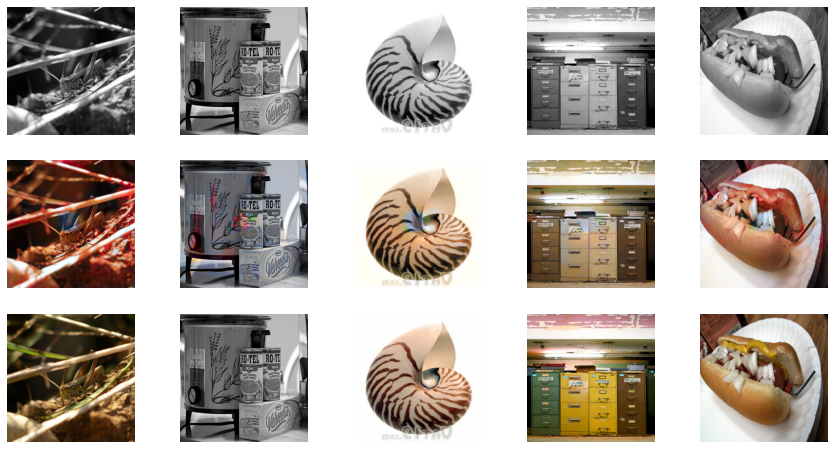


Epoch 33/45
Iteration 10/250
loss_D_fake: 0.54181
loss_D_real: 0.52245
loss_D: 0.53213
loss_G_GAN: 1.16064
loss_G_L1: 8.35140
loss_G: 9.51204


  0%|          | 0/250 [00:00<?, ?it/s]

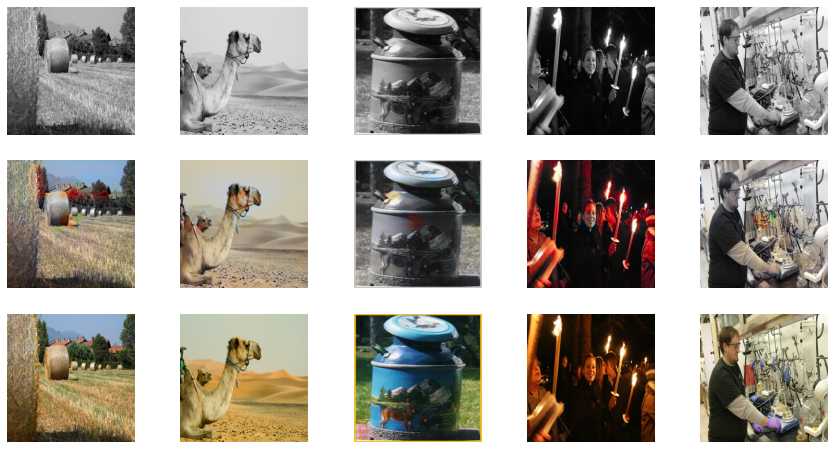


Epoch 34/45
Iteration 1/250
loss_D_fake: 0.95150
loss_D_real: 0.15696
loss_D: 0.55423
loss_G_GAN: 1.11204
loss_G_L1: 8.33792
loss_G: 9.44997


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 14 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


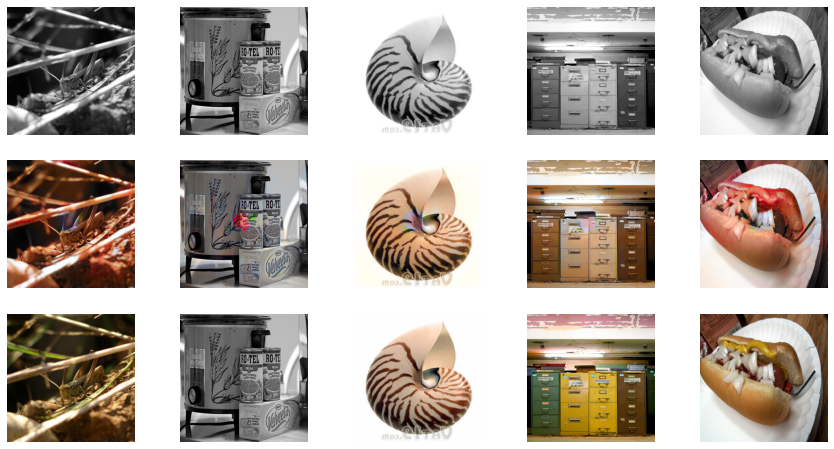


Epoch 34/45
Iteration 10/250
loss_D_fake: 0.51336
loss_D_real: 0.47732
loss_D: 0.49534
loss_G_GAN: 1.19386
loss_G_L1: 7.97302
loss_G: 9.16688


  0%|          | 0/250 [00:00<?, ?it/s]

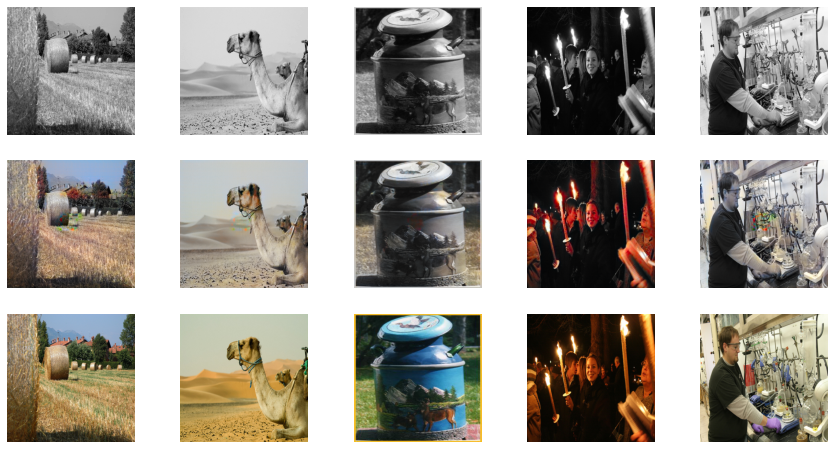


Epoch 35/45
Iteration 1/250
loss_D_fake: 0.78664
loss_D_real: 0.13259
loss_D: 0.45962
loss_G_GAN: 1.15238
loss_G_L1: 8.50829
loss_G: 9.66067


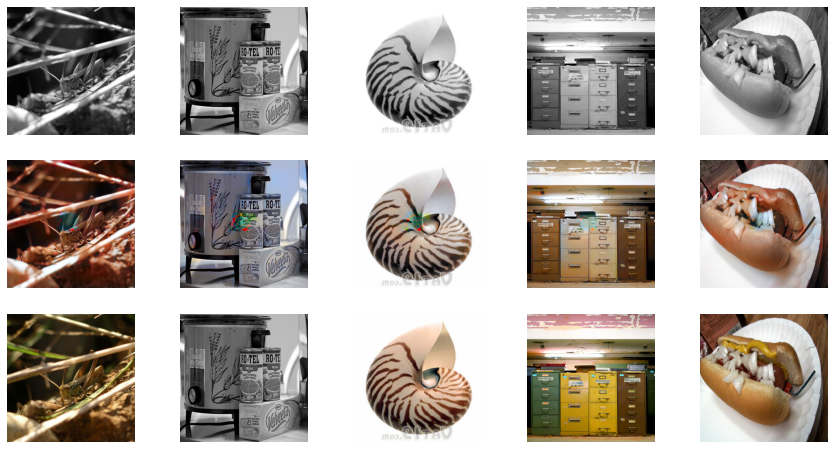


Epoch 35/45
Iteration 10/250
loss_D_fake: 0.51210
loss_D_real: 0.42355
loss_D: 0.46782
loss_G_GAN: 1.26292
loss_G_L1: 7.94368
loss_G: 9.20661


  0%|          | 0/250 [00:00<?, ?it/s]

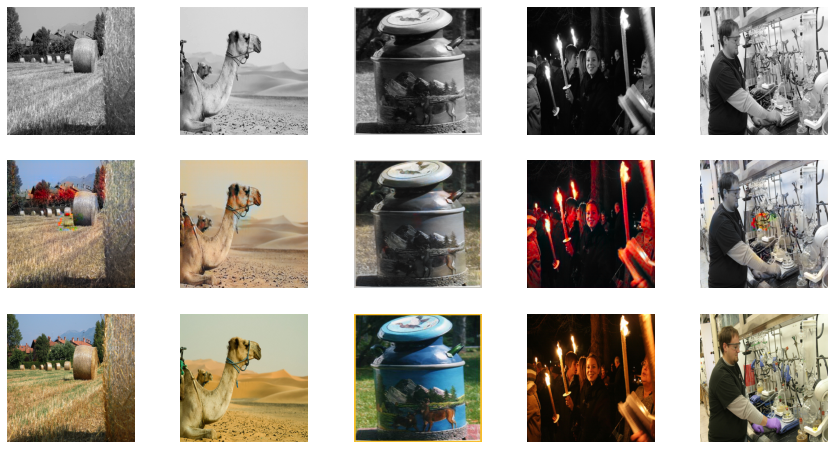


Epoch 36/45
Iteration 1/250
loss_D_fake: 1.33781
loss_D_real: 0.08460
loss_D: 0.71120
loss_G_GAN: 1.16906
loss_G_L1: 8.11617
loss_G: 9.28523


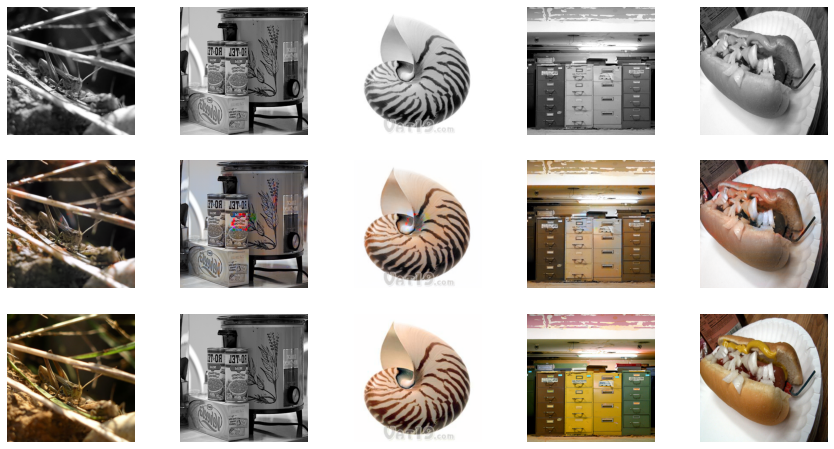


Epoch 36/45
Iteration 10/250
loss_D_fake: 0.57651
loss_D_real: 0.49019
loss_D: 0.53335
loss_G_GAN: 1.22450
loss_G_L1: 7.82441
loss_G: 9.04892


  0%|          | 0/250 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


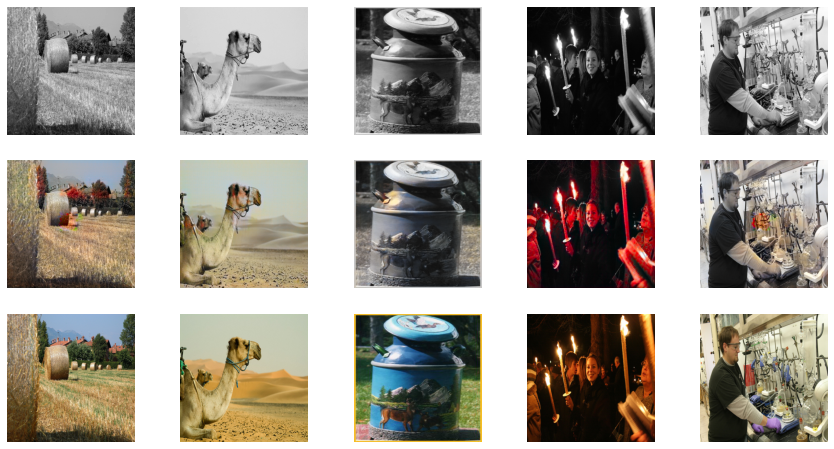


Epoch 37/45
Iteration 1/250
loss_D_fake: 1.41533
loss_D_real: 0.09963
loss_D: 0.75748
loss_G_GAN: 1.04457
loss_G_L1: 7.73146
loss_G: 8.77603


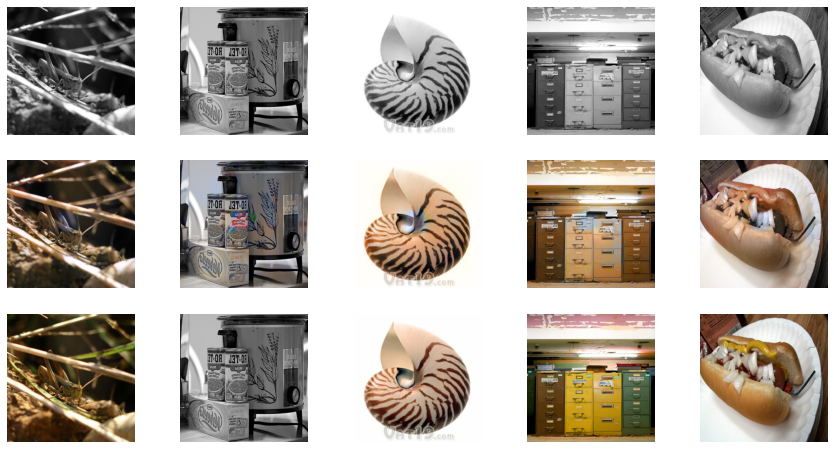


Epoch 37/45
Iteration 10/250
loss_D_fake: 0.58669
loss_D_real: 0.49822
loss_D: 0.54245
loss_G_GAN: 1.17764
loss_G_L1: 7.71500
loss_G: 8.89263


  0%|          | 0/250 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


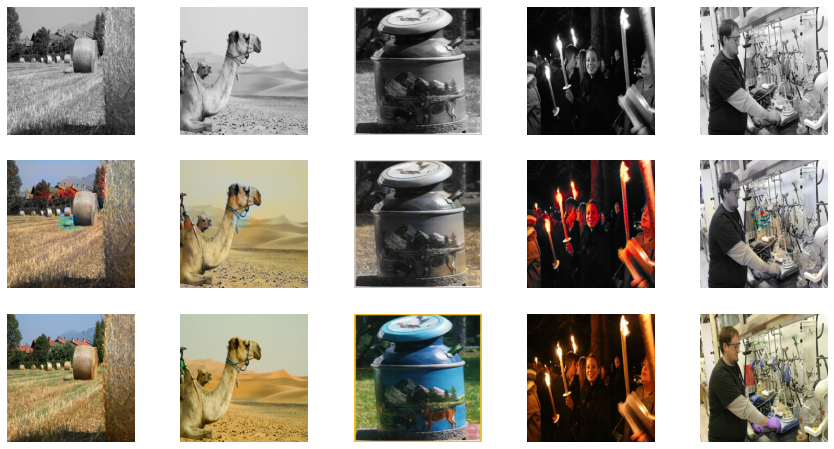


Epoch 38/45
Iteration 1/250
loss_D_fake: 0.55636
loss_D_real: 0.17772
loss_D: 0.36704
loss_G_GAN: 1.06949
loss_G_L1: 8.24529
loss_G: 9.31478


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 21 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


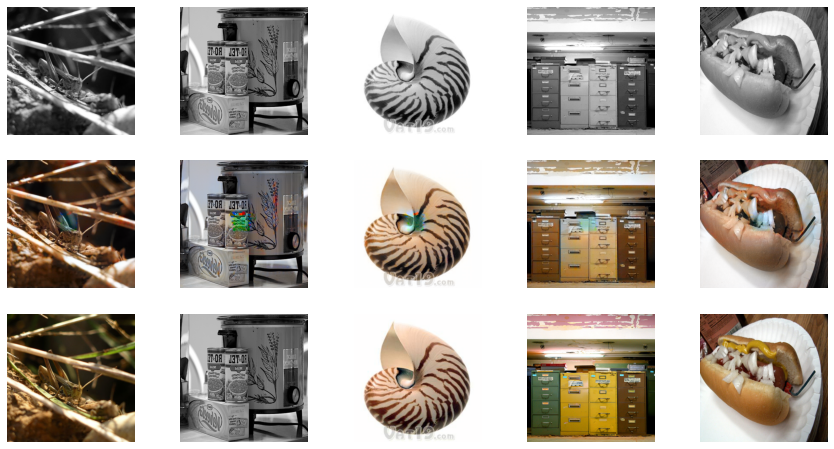


Epoch 38/45
Iteration 10/250
loss_D_fake: 0.56529
loss_D_real: 0.45106
loss_D: 0.50817
loss_G_GAN: 1.18470
loss_G_L1: 7.69076
loss_G: 8.87547


  0%|          | 0/250 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 17 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 11 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


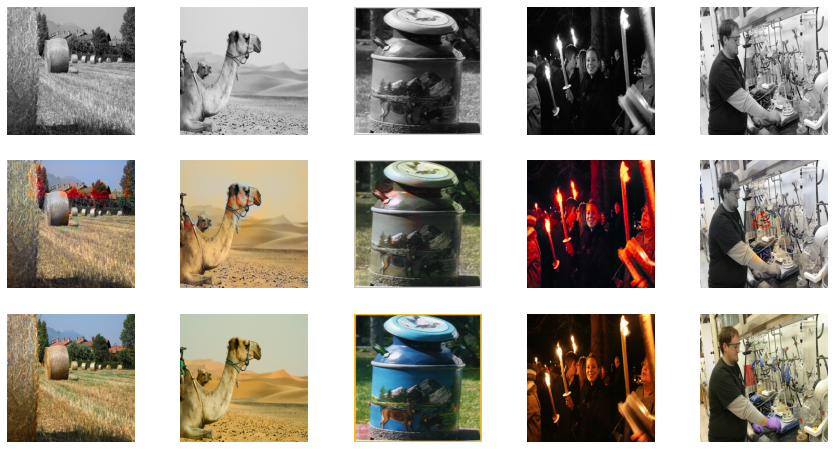


Epoch 39/45
Iteration 1/250
loss_D_fake: 1.15646
loss_D_real: 0.16633
loss_D: 0.66140
loss_G_GAN: 1.04420
loss_G_L1: 7.62954
loss_G: 8.67374


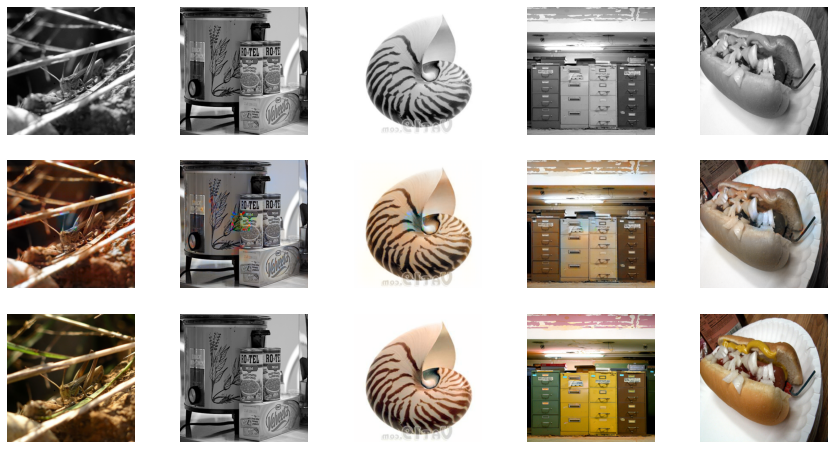


Epoch 39/45
Iteration 10/250
loss_D_fake: 0.60782
loss_D_real: 0.56369
loss_D: 0.58575
loss_G_GAN: 1.15000
loss_G_L1: 7.73404
loss_G: 8.88404


  0%|          | 0/250 [00:00<?, ?it/s]

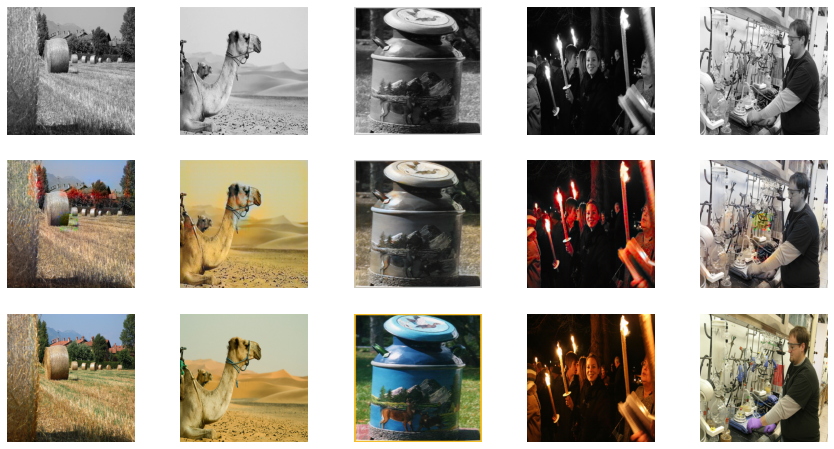


Epoch 40/45
Iteration 1/250
loss_D_fake: 1.22120
loss_D_real: 0.15588
loss_D: 0.68854
loss_G_GAN: 1.05978
loss_G_L1: 7.81657
loss_G: 8.87636


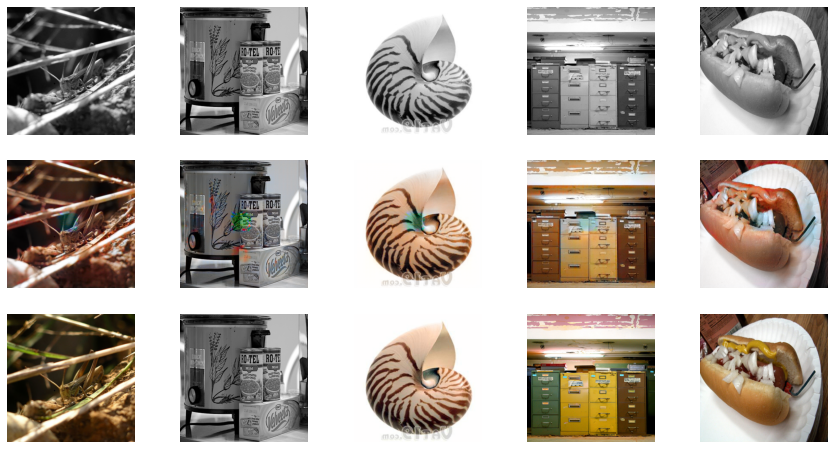


Epoch 40/45
Iteration 10/250
loss_D_fake: 0.62339
loss_D_real: 0.52318
loss_D: 0.57328
loss_G_GAN: 1.17411
loss_G_L1: 7.59704
loss_G: 8.77114


  0%|          | 0/250 [00:00<?, ?it/s]

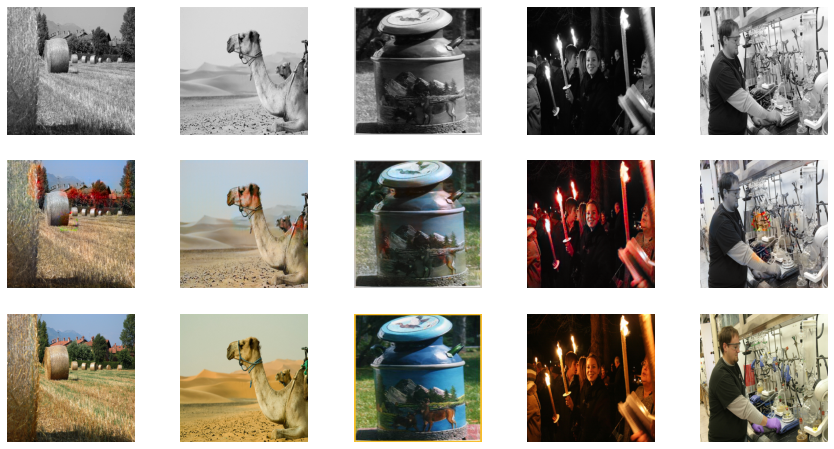


Epoch 41/45
Iteration 1/250
loss_D_fake: 0.83547
loss_D_real: 0.20360
loss_D: 0.51953
loss_G_GAN: 0.94449
loss_G_L1: 7.71590
loss_G: 8.66039


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 30 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


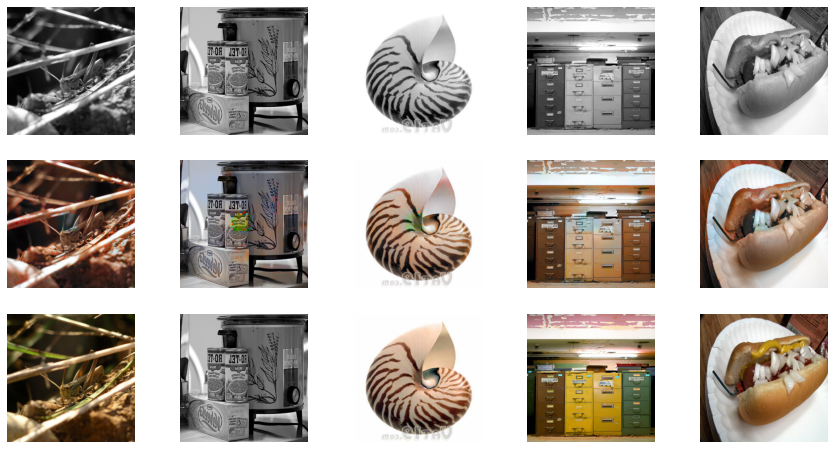


Epoch 41/45
Iteration 10/250
loss_D_fake: 0.62867
loss_D_real: 0.49615
loss_D: 0.56241
loss_G_GAN: 1.13424
loss_G_L1: 7.59752
loss_G: 8.73176


  0%|          | 0/250 [00:00<?, ?it/s]

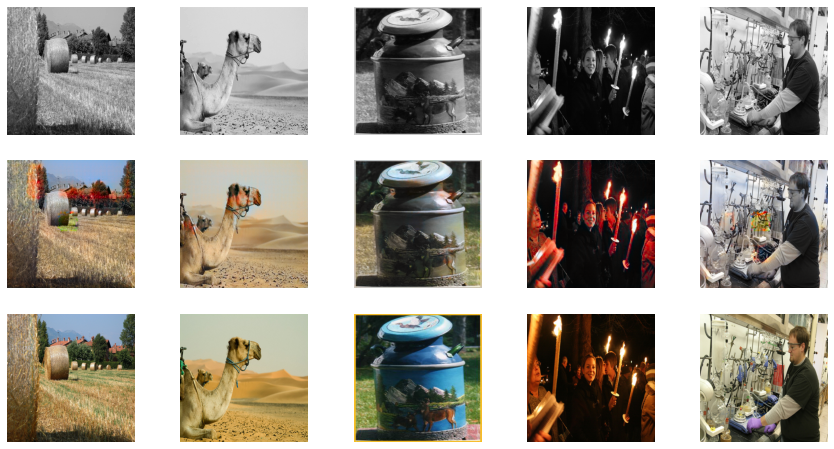


Epoch 42/45
Iteration 1/250
loss_D_fake: 1.39659
loss_D_real: 0.17531
loss_D: 0.78595
loss_G_GAN: 0.84454
loss_G_L1: 7.71831
loss_G: 8.56286


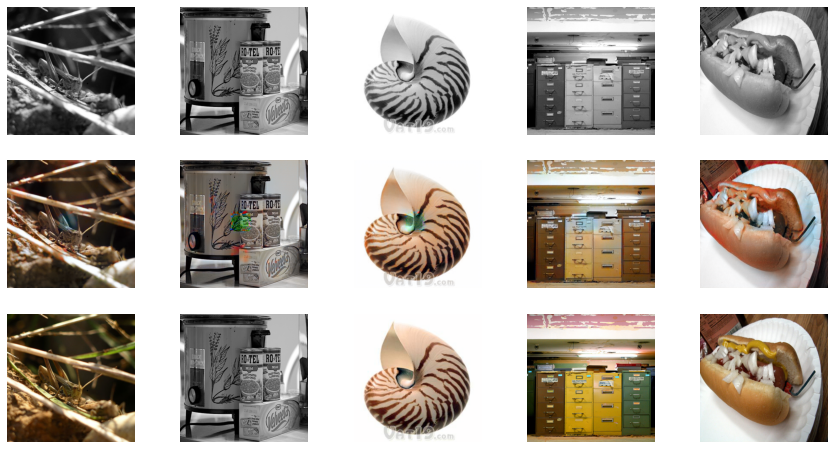


Epoch 42/45
Iteration 10/250
loss_D_fake: 0.67722
loss_D_real: 0.52570
loss_D: 0.60146
loss_G_GAN: 1.12664
loss_G_L1: 7.47295
loss_G: 8.59959


  0%|          | 0/250 [00:00<?, ?it/s]

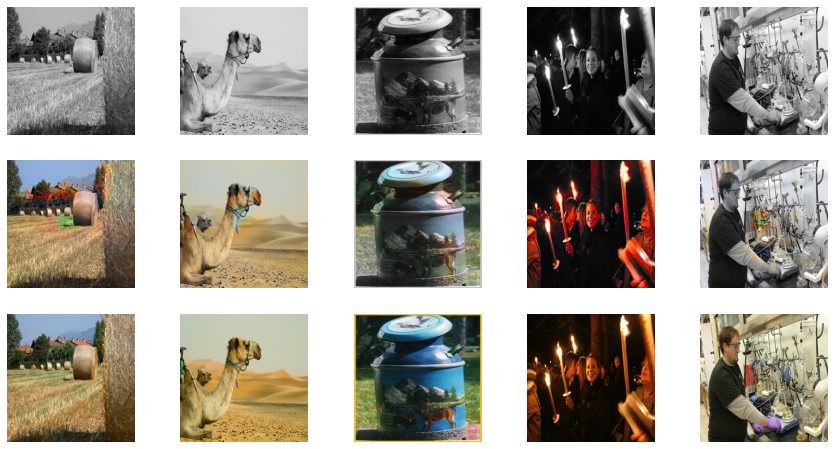


Epoch 43/45
Iteration 1/250
loss_D_fake: 0.71768
loss_D_real: 0.22421
loss_D: 0.47095
loss_G_GAN: 0.93366
loss_G_L1: 7.39810
loss_G: 8.33176


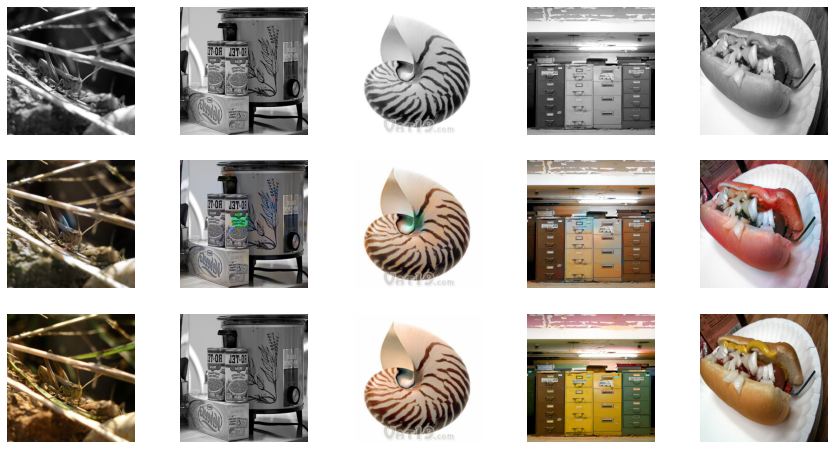


Epoch 43/45
Iteration 10/250
loss_D_fake: 0.60249
loss_D_real: 0.50464
loss_D: 0.55357
loss_G_GAN: 1.07693
loss_G_L1: 7.38032
loss_G: 8.45725


  0%|          | 0/250 [00:00<?, ?it/s]

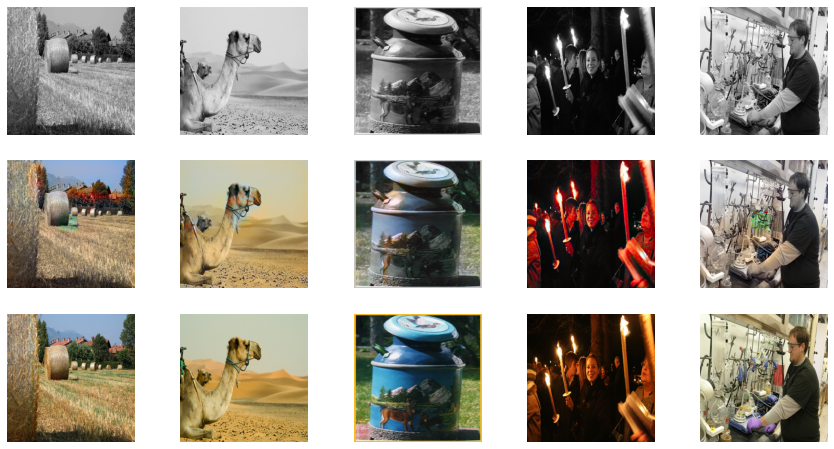


Epoch 44/45
Iteration 1/250
loss_D_fake: 1.21158
loss_D_real: 0.18058
loss_D: 0.69608
loss_G_GAN: 0.84130
loss_G_L1: 7.68954
loss_G: 8.53084


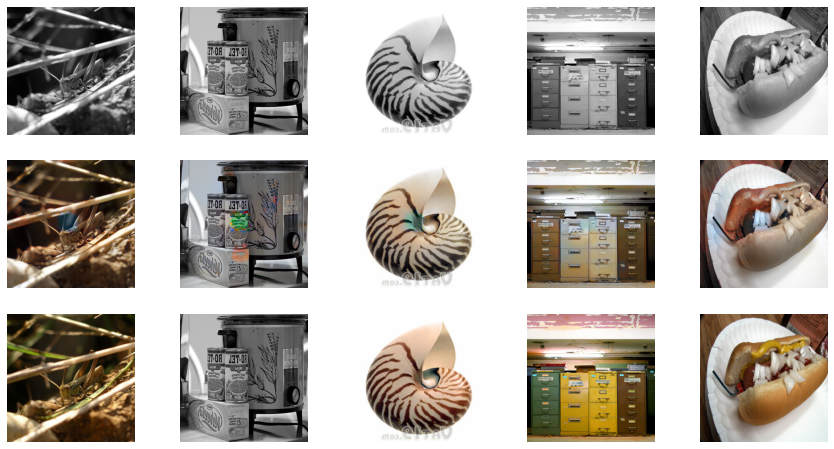


Epoch 44/45
Iteration 10/250
loss_D_fake: 0.61795
loss_D_real: 0.53725
loss_D: 0.57760
loss_G_GAN: 1.21864
loss_G_L1: 7.29210
loss_G: 8.51074


  0%|          | 0/250 [00:00<?, ?it/s]

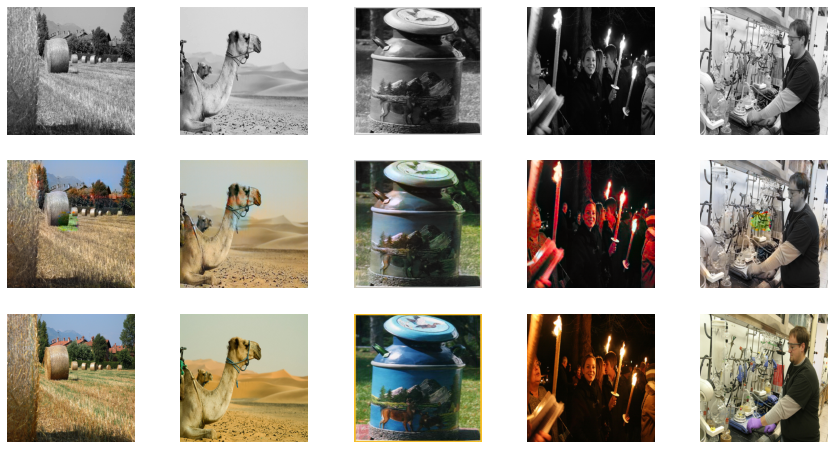


Epoch 45/45
Iteration 1/250
loss_D_fake: 1.31785
loss_D_real: 0.21936
loss_D: 0.76861
loss_G_GAN: 0.81336
loss_G_L1: 8.16205
loss_G: 8.97541


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 24 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


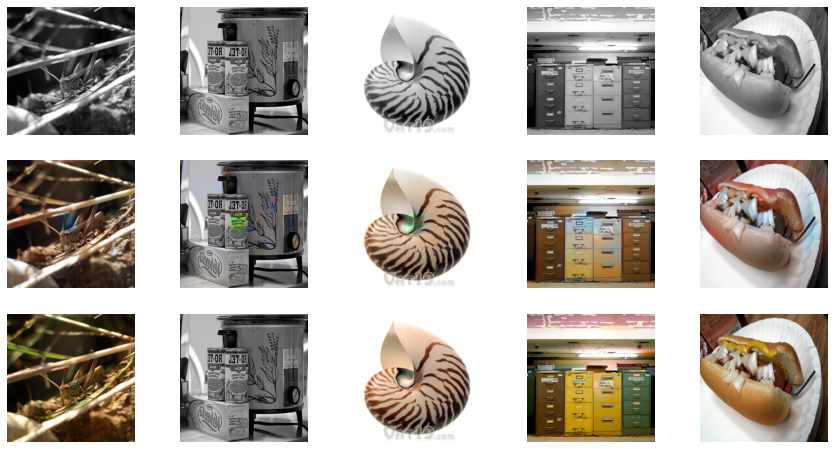


Epoch 45/45
Iteration 10/250
loss_D_fake: 0.66107
loss_D_real: 0.50340
loss_D: 0.58223
loss_G_GAN: 1.13504
loss_G_L1: 7.16501
loss_G: 8.30005


In [ ]:
results = df.to_dict('records')
show=False
def train_modell(model, train_dl, epochs, display_every=1):
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intrvals
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to 
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data) 
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i in [1,10]:
                visualize(model, data, save=False) # function displaying the model's outputs
                show=True
            else:
                show=False
            if show:
                print(f"\nEpoch {e+31}/{epochs+30}")
                print(f"Iteration {i}/{len(train_dl)}")
            results.append(log_results(loss_meter_dict,show=show)) # function to print out the losses
                

#model = MainModel()
train_modell(model, train_dl, 15) # from epoch 30 to 45

In [ ]:
torch.save(model, '/content/drive/MyDrive/DNN_final_project/5k_model/model_45epoch.pt')
df=pd.DataFrame(results)
df.to_csv('/content/drive/MyDrive/DNN_final_project/5k_model/Loss_45epoch.csv')

In [ ]:
map_location=torch.device('cuda')
model45= torch.load('/content/drive/MyDrive/DNN_final_project/5k_model/model_45epoch.pt')

In [ ]:
for data in tqdm(test_coco):
  visualize(model45 ,data , save=False)
  break

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/DNN_final_project/5k_model/Loss_45epoch.csv')

In [ ]:
df.columns

Index(['Unnamed: 0', 'Unnamed: 0.1', 'loss_D_fake', 'loss_D_real', 'loss_D',
       'loss_G_GAN', 'loss_G_L1', 'loss_G'],
      dtype='object')

Text(0.5, 0, 'Iteration')

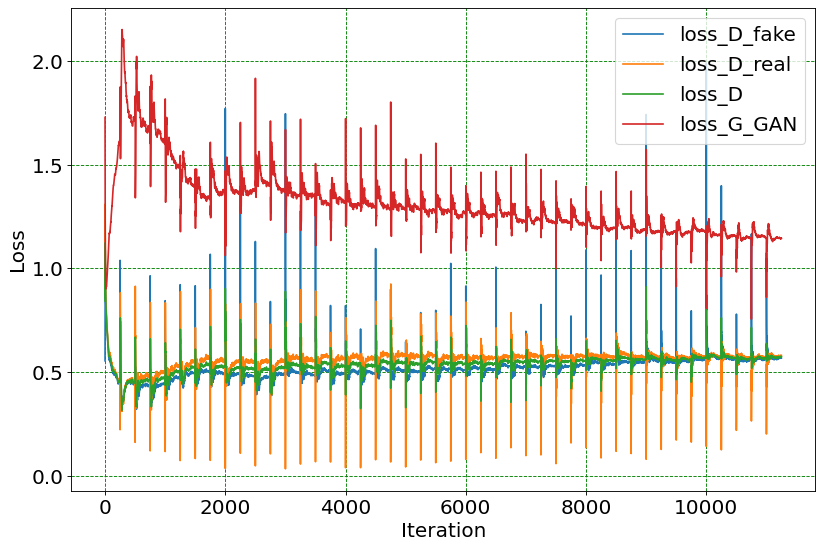

In [ ]:
#all
plt.rcParams.update({'font.size': 18})
plt.figure(figsize=(12, 8), dpi=80)
plt.grid(color = 'green', linestyle = '--', linewidth = 0.8)
for i in df.columns[2:6]:
  plt.plot(np.arange(len(df[i])),df[i],label=i)
plt.legend(loc='upper right')
plt.ylabel('Loss')
plt.xlabel('Iteration')

In [ ]:
plt.rcParams.update({'font.size': 18})

Text(0.5, 0, 'Iteration')

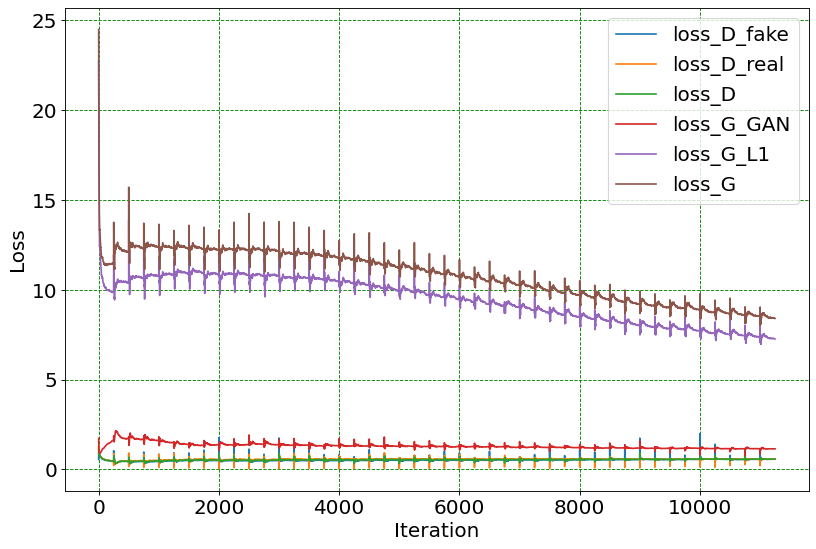

In [ ]:
#all
plt.rcParams.update({'font.size': 18})
plt.rcParams.update({'font.size': 18})
plt.figure(figsize=(12, 8), dpi=80)
plt.grid(color = 'green', linestyle = '--', linewidth = 0.8)
for i in df.columns[2:]:
  plt.plot(np.arange(len(df[i])),df[i],label=i)
plt.legend(loc='upper right')
plt.ylabel('Loss')
plt.xlabel('Iteration')

Text(0.5, 0, 'Iteration')

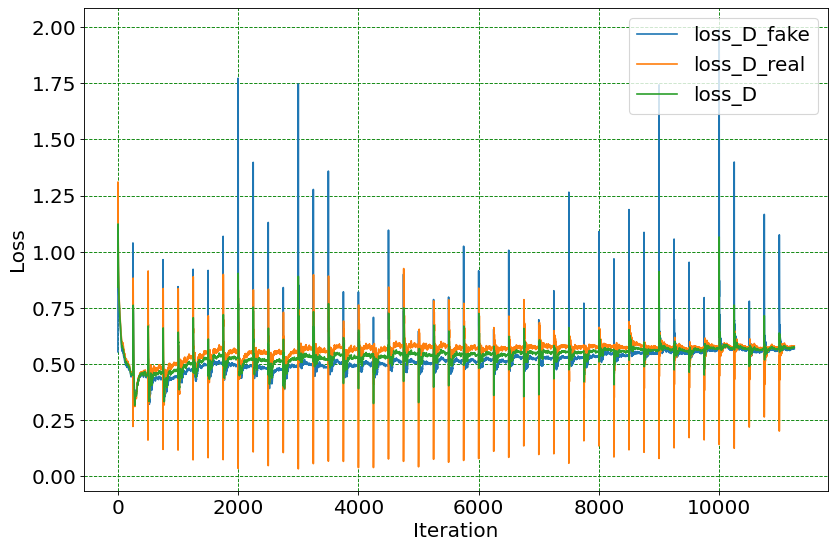

In [ ]:
#Loss D
plt.rcParams.update({'font.size': 18})
plt.figure(figsize=(12, 8), dpi=80)
plt.grid(color = 'green', linestyle = '--', linewidth = 0.8)
for i in df.columns[2:5]:
  plt.plot(np.arange(len(df[i])),df[i],label=i)
plt.legend(loc='upper right')
plt.ylabel('Loss')
plt.xlabel('Iteration')

Text(0.5, 0, 'Iteration')

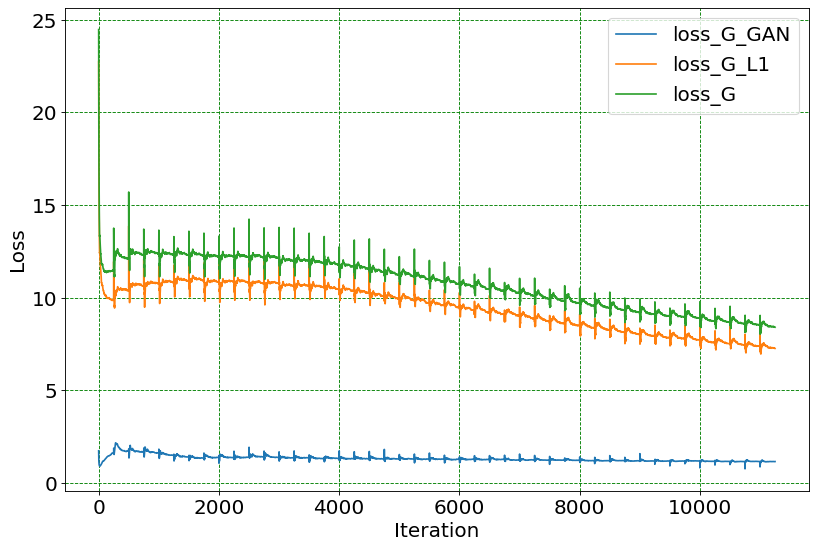

In [ ]:
#Loss G
plt.rcParams.update({'font.size': 18})
plt.figure(figsize=(12, 8), dpi=80)
plt.grid(color = 'green', linestyle = '--', linewidth = 0.8)
for i in df.columns[5:]:
  plt.plot(np.arange(len(df[i])),df[i],label=i)
plt.legend(loc='upper right')
plt.ylabel('Loss')
plt.xlabel('Iteration')

Text(0.5, 0, 'Iteration')

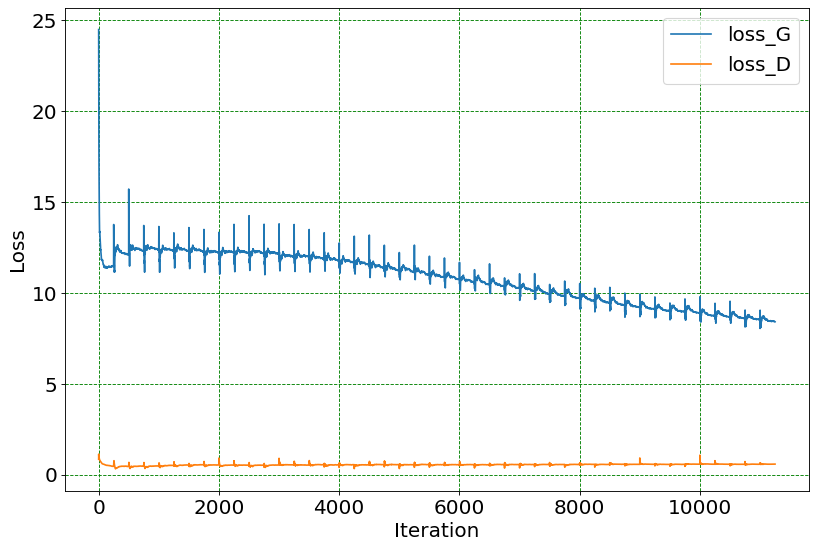

In [ ]:
#Loss D , G
plt.rcParams.update({'font.size': 18})
plt.figure(figsize=(12, 8), dpi=80)
plt.grid(color = 'green', linestyle = '--', linewidth = 0.8)
plt.plot(np.arange(len(df['loss_G'])),df['loss_G'],label='loss_G')
plt.plot(np.arange(len(df['loss_D'])),df['loss_D'],label='loss_D')
plt.legend(loc='upper right')
plt.ylabel('Loss')
plt.xlabel('Iteration')

### test coco dataset on our model :

In [ ]:
from fastai.data.external import untar_data, URLs
coco_path = untar_data(URLs.COCO_SAMPLE)
coco_path = str(coco_path) + "/train_sample"
use_colab = True

if use_colab == True:
    path = coco_path
else:
    path = "Your path to the dataset"
    
paths = glob.glob(path + "/*.jpg") # Grabbing all the image file names
np.random.seed(123)
paths_subset_coco = np.random.choice(paths, 10_000, replace=False) # choosing 1000 images randomly


In [ ]:
map_location=torch.device('cuda')
model45= torch.load('/content/drive/MyDrive/model_45epoch.pt',map_location)

625


/usr/local/lib/python3.8/dist-packages/torchvision/transforms/transforms.py:329: UserWarning: Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. Please use InterpolationMode enum.
  warnings.warn(


  0%|          | 0/625 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 54 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


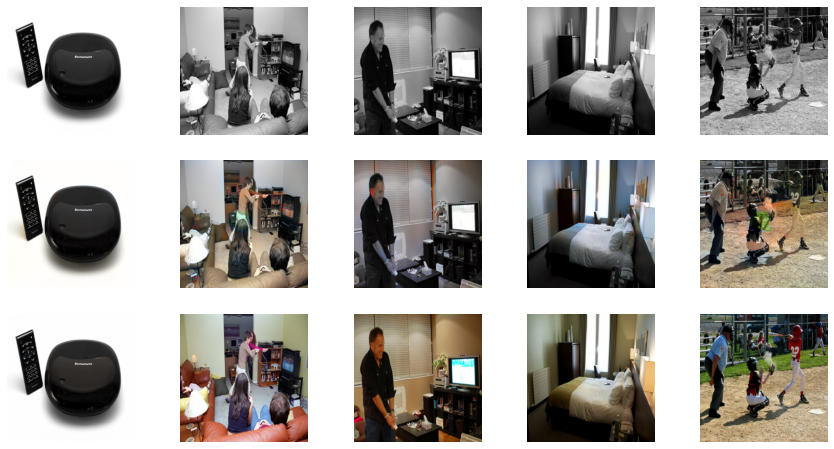

In [ ]:
test_coco = make_dataloaders(paths=paths_subset_coco, split='val')
print(len(test_coco))
for data in tqdm(test_coco):
  visualize(model45,data , save=False)
  break

## Model 2 :


- step.1: The backbone of the generator (the down sampling path) is a pretrained model for classification (on ImageNet)

- step.2: The whole generator will be pretrained on the task of colorization with L1 loss.

- step3: use a pretrained ResNet18 as the backbone of my U-Net(fastai library's).

   - train the U-Net on our training set with only L1 Loss
   
   - move to the combined adversarial and L1 loss, as we did in the previous section.
   
   - create_body function loads the pretrained weights of the ResNet18 architecture.
   
   - cuts the model to remove the last two layers: GlobalAveragePooling and a Linear layer for the ImageNet classifier
   
   - DynamicUnet uses this backbone to build a U-Net with the needed output channels (2 in our case) and with an input size of 256

###  Using a new generator :

In [ ]:
#!pip install fastai==2.4
from fastai.vision.learner import create_body
from torchvision.models.resnet import resnet18
from fastai.vision.models.unet import DynamicUnet

In [ ]:
def build_res_unet(n_input=1, n_output=2, size=256):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    body = create_body(resnet18, pretrained=True, n_in=n_input, cut=-2)
    net_G = DynamicUnet(body, n_output, (size, size)).to(device)
    return net_G

### Pretraining the generator for colorization task :

- pretrain the generator for 20 epochs & save the weights.

- use this model as the generator for our GAN and train the whole network as before.

In [ ]:
def pretrain_generator(net_G, train_dl, opt, criterion, epochs):
    for e in range(epochs):
        loss_meter = AverageMeter()
        for data in tqdm(train_dl):
            L, ab = data['L'].to(device), data['ab'].to(device)
            preds = net_G(L)
            loss = criterion(preds, ab)
            opt.zero_grad()
            loss.backward()
            opt.step()
            
            loss_meter.update(loss.item(), L.size(0))
            
        print(f"Epoch {e + 1}/{epochs}")
        print(f"L1 Loss: {loss_meter.avg:.5f}")

net_G = build_res_unet(n_input=1, n_output=2, size=256)
opt = optim.Adam(net_G.parameters(), lr=1e-4)
criterion = nn.L1Loss()        
pretrain_generator(net_G, train_dl, opt, criterion, 20)
torch.save(net_G.state_dict(), "/content/drive/MyDrive/DNN_final_project/5k_model/res18-unet.pt")

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 1/20
L1 Loss: 0.09046


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 2/20
L1 Loss: 0.08700


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 3/20
L1 Loss: 0.08656


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 4/20
L1 Loss: 0.08615


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 5/20
L1 Loss: 0.08588


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 6/20
L1 Loss: 0.08561


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 7/20
L1 Loss: 0.08546


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 8/20
L1 Loss: 0.08517


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 9/20
L1 Loss: 0.08505


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 10/20
L1 Loss: 0.08479


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 11/20
L1 Loss: 0.08443


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 12/20
L1 Loss: 0.08427


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 13/20
L1 Loss: 0.08384


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 14/20
L1 Loss: 0.08385


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 15/20
L1 Loss: 0.08284


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 16/20
L1 Loss: 0.08286


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 17/20
L1 Loss: 0.08224


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 18/20
L1 Loss: 0.08167


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 19/20
L1 Loss: 0.08148


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 20/20
L1 Loss: 0.08067


In [ ]:
#loading the saved weights for the generator (which you have saved in the previous section)
net_G = build_res_unet(n_input=1, n_output=2, size=256)
net_G.load_state_dict(torch.load("/content/drive/MyDrive/DNN_final_project/5k_model/res18-unet.pt", map_location=device))

<All keys matched successfully>

### Main Model :

In [ ]:
results = []
show=False

model = MainModel(net_G=net_G)
def train_model(model, train_dl, epochs, display_every=1):
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intrvals
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to 
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data) 
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i in [1,5]:
                visualize(model, data, save=False) # function displaying the model's outputs
                show=True
            else:
                show=False
            if show:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
            results.append(log_results(loss_meter_dict,show=show)) # function to print out the losses
                
train_model(model, train_dl,20)

In [ ]:
torch.save(model, '/content/drive/MyDrive/DNN_final_project/5k_model/pretrained_model20ep.pt')
df1=pd.DataFrame(results)
df1.to_csv('/content/drive/MyDrive/DNN_final_project/5k_model/PretrainedLoss20ep.csv')

We can take a look at the model structure:

In [ ]:
map_location=torch.device('cpu')
model = torch.load('/content/drive/MyDrive/DNN_final_project/5k_model/pretrained_model20ep.pt')
model.eval()

MainModel(
  (net_G): DynamicUnet(
    (layers): ModuleList(
      (0): Sequential(
        (0): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
        (4): Sequential(
          (0): BasicBlock(
            (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
            (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (relu): ReLU(inplace=True)
            (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
            (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          )
          (1): BasicBlock(
            (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), 

Text(0.5, 0, 'Iteration')

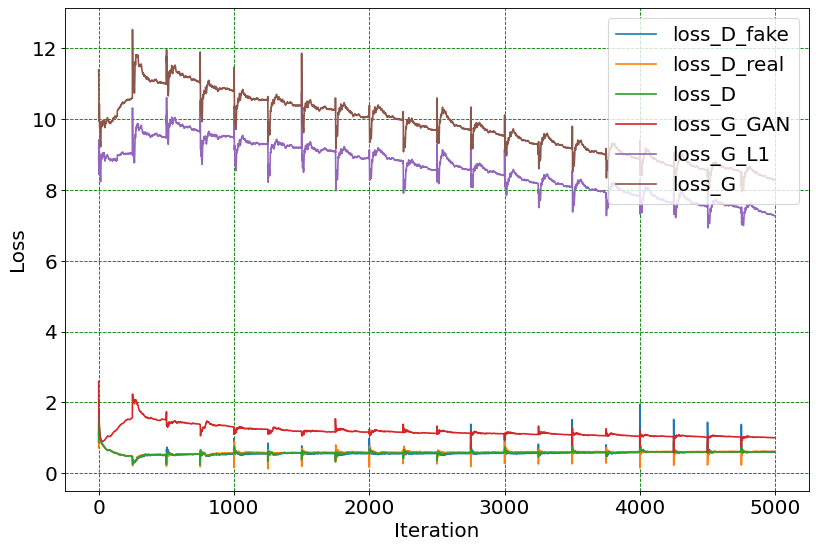

In [ ]:
#all
plt.rcParams.update({'font.size': 18})
plt.figure(figsize=(12, 8), dpi=80)
plt.grid(color = 'green', linestyle = '--', linewidth = 0.8)
for i in df1.columns:
  plt.plot(np.arange(len(df1[i])),df1[i],label=i)
plt.legend(loc='upper right')
plt.ylabel('Loss')
plt.xlabel('Iteration')

  0%|          | 0/250 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


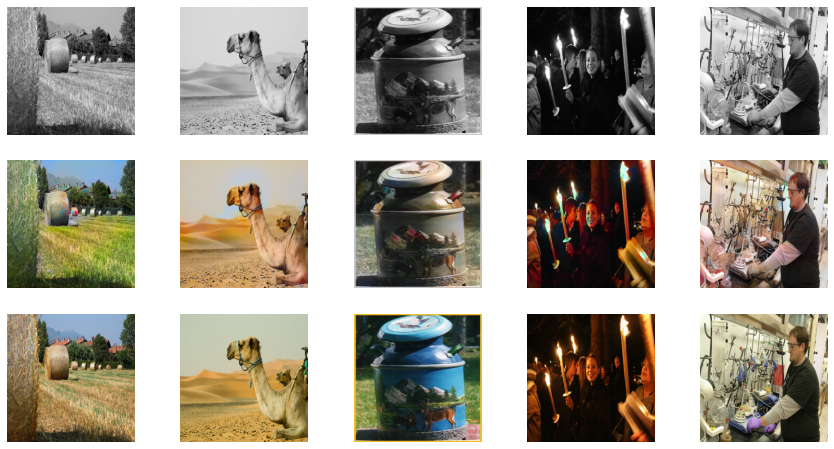

In [ ]:
for data in tqdm(train_dl):
 visualize(model,data , save=False)
 break

  0%|          | 0/63 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


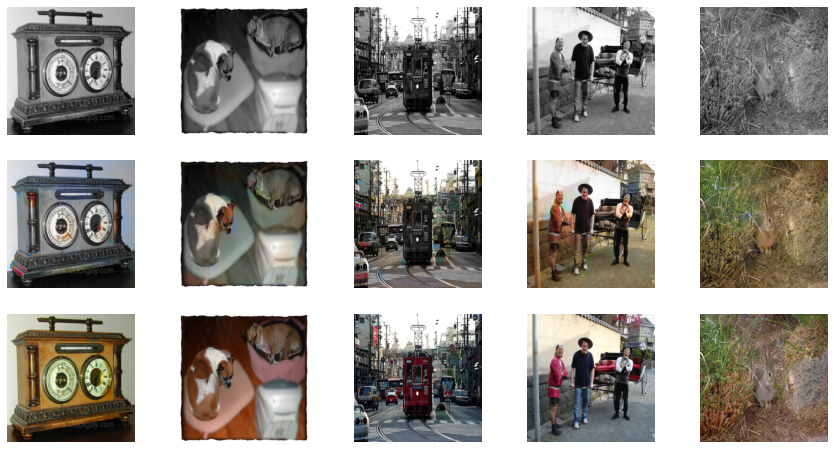

In [ ]:
for data in tqdm(val_dl):
 visualize(model,data , save=False)
 break

### Test the Model :

- As we mentioned before because of our system we were not able to do models for more than 45 epoches for first model and 20 epoches for pre-trained. as a result, when we are testing our models it not gives us reasonable results but we are sure about our model, it will give good performance when we will do it by more epoches.

- just for showing our models performance we find the trained result of similar model & visualized it here.

 

In [ ]:
!pip install --upgrade --no-cache-dir gdown

In [ ]:
 !gdown --id 1lR6DcS4m5InSbZ5y59zkH2mHt_4RQ2KV

/usr/local/lib/python3.8/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1lR6DcS4m5InSbZ5y59zkH2mHt_4RQ2KV
To: /content/final_model_weights.pt
100% 136M/136M [00:02<00:00, 63.1MB/s]


In [ ]:
 net_G = build_res_unet(n_input=1, n_output=2, size=256)
 net_G.load_state_dict(torch.load("res18-unet.pt", map_location=device))
 model = MainModel(net_G=net_G)
 model.load_state_dict(torch.load("final_model_weights.pt", map_location=device))

model initialized with norm initialization


<All keys matched successfully>

In [ ]:
test_data=make_dataloaders(paths=test, split='val')


/usr/local/lib/python3.8/dist-packages/torchvision/transforms/transforms.py:329: UserWarning: Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. Please use InterpolationMode enum.
  warnings.warn(


  0%|          | 0/250 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


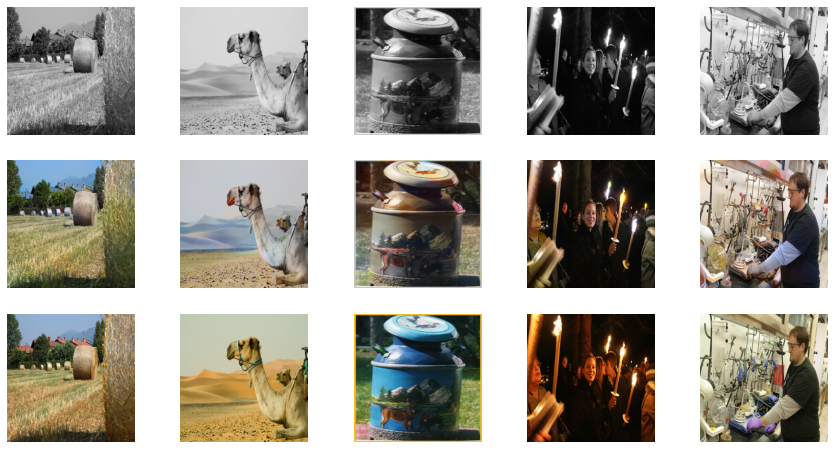

In [ ]:
for data in tqdm(train_dl):
 visualize(model,data , save=False)
 break

  0%|          | 0/63 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


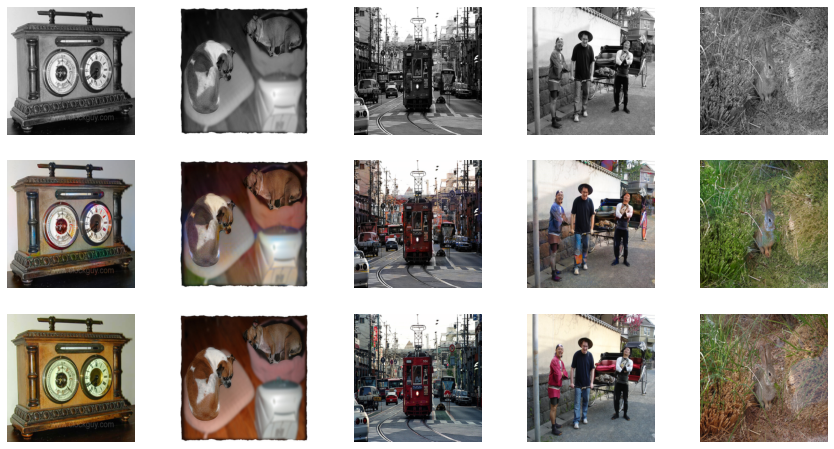

In [ ]:
for data in tqdm(val_dl):
 visualize(model,data , save=False)
 break

### Coco Data set:

- As we already used the pre-trained model for the imagenet, it was not reasonable to use same dataset to test.

- for showing final result we test the coco dataset.

In [ ]:
from fastai.data.external import untar_data, URLs
coco_path = untar_data(URLs.COCO_SAMPLE)
coco_path = str(coco_path) + "/train_sample"
use_colab = True

In [ ]:

if use_colab == True:
    path = coco_path
else:
    path = "Your path to the dataset"
    
paths = glob.glob(path + "/*.jpg") # Grabbing all the image file names
np.random.seed(123)
paths_subset_coco = np.random.choice(paths, 10_000, replace=False) # choosing 1000 images randomly


In [ ]:
test_coco = make_dataloaders(paths=paths_subset_coco, split='val')
print(len(test_coco))

625


/usr/local/lib/python3.8/dist-packages/torchvision/transforms/transforms.py:280: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


### test Coco Dataset with the full trained model:

  0%|          | 0/625 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


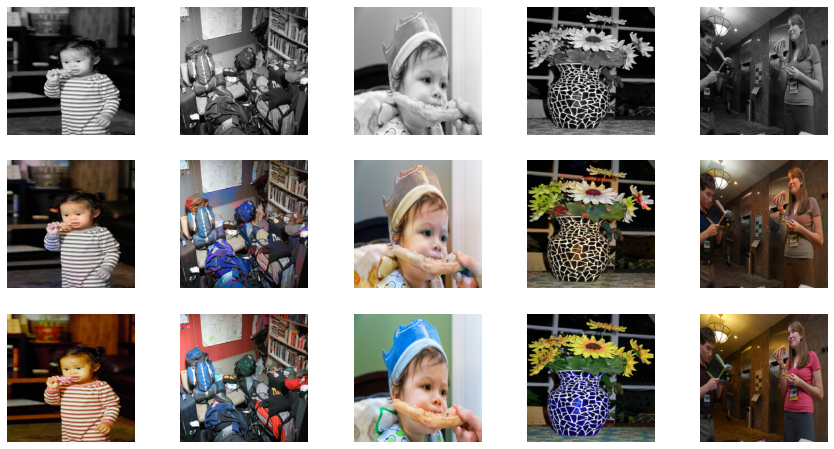

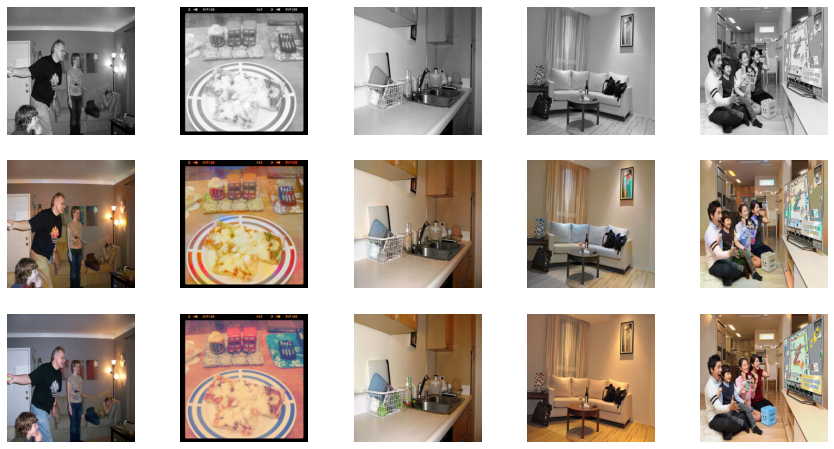

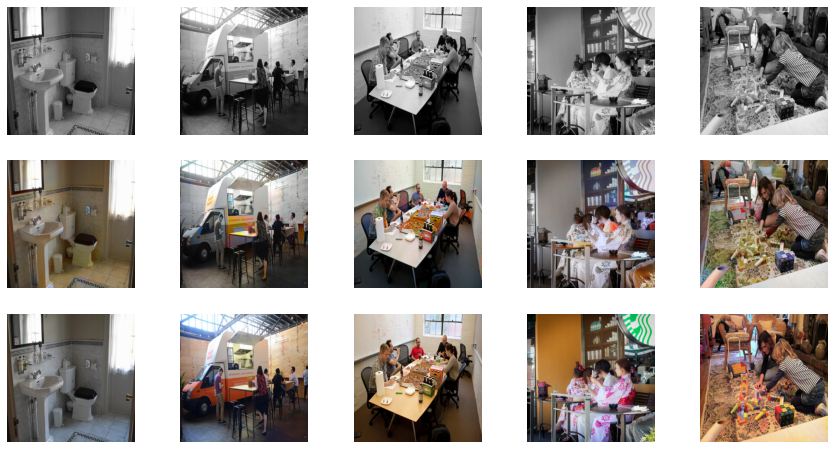

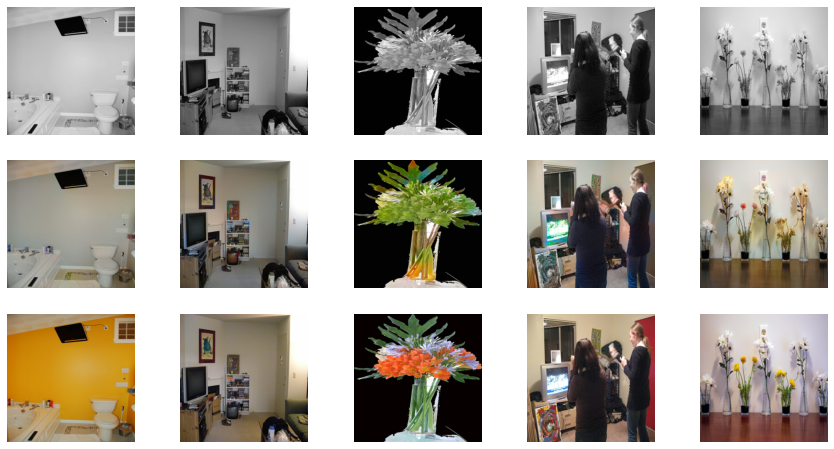

KeyboardInterrupt: ignored

In [ ]:
test_coco = make_dataloaders(paths=paths_subset_coco, split='val')
print(len(test_coco))
for data in tqdm(test_coco):
  visualize(model,data , save=False)
  break

our ne images

In [ ]:
path='/content/we'
test=glob.glob(path+ "/*.jpg")
test_data=make_dataloaders(paths=test, split='val')

/usr/local/lib/python3.8/dist-packages/torchvision/transforms/transforms.py:280: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


  0%|          | 0/1 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


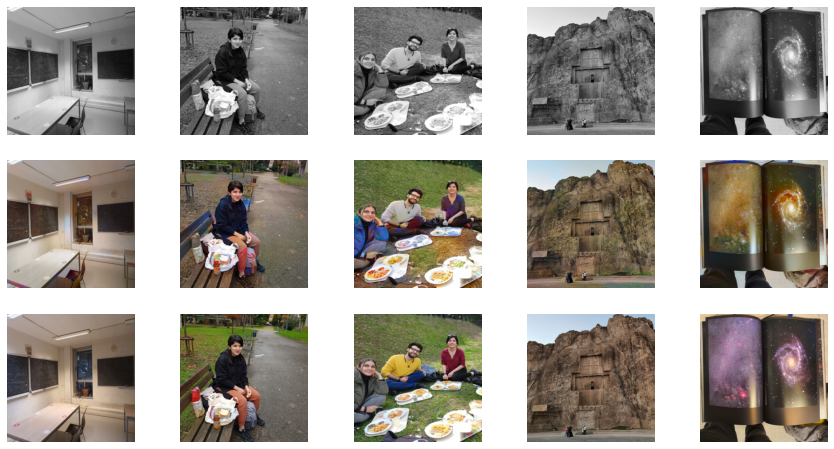

In [ ]:
for data in tqdm(test_data):
  visualize(model,data , save=False)

In [ ]:
path='/content/we'
test=glob.glob(path+ "/*.jpg")
test_data=make_dataloaders(paths=test, split='val')

  0%|          | 0/1 [00:00<?, ?it/s]

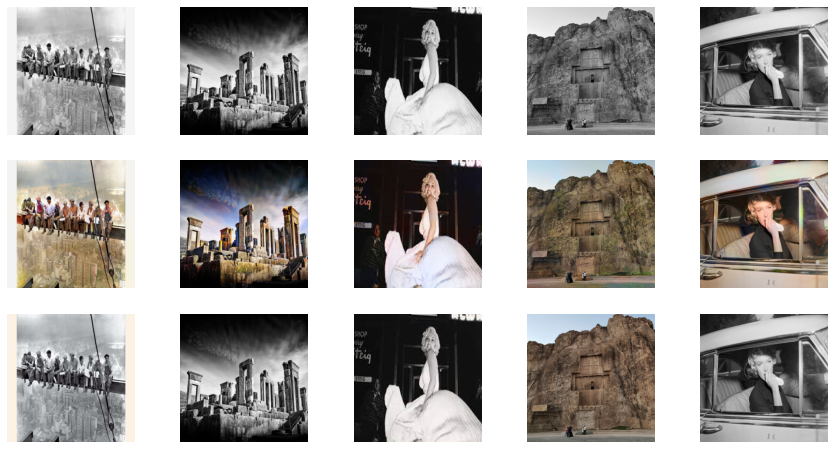

In [ ]:
for data in tqdm(test_data):
  visualize(model,data , save=True)

In [ ]:
path='/content/Untitled Folder'
test=glob.glob(path+ "/*.jpg")
test_data=make_dataloaders(paths=test, split='val')

  0%|          | 0/1 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


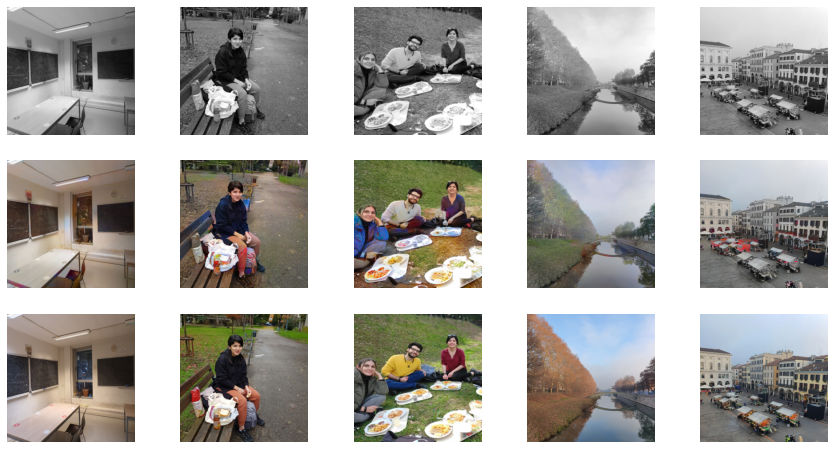

In [ ]:
for data in tqdm(test_data):
  visualize(model,data , save=True)